In [7]:
import pandas as pd
import matplotlib.pyplot as plt

In [100]:
df0 = pd.read_csv('/Users/andaks/Downloads/round-3-island-data-bottle/prices_round_3_day_0.csv', sep=';')
df1 = pd.read_csv('/Users/andaks/Downloads/round-3-island-data-bottle/prices_round_3_day_1.csv', sep=';')
df2 = pd.read_csv('/Users/andaks/Downloads/round-3-island-data-bottle/prices_round_3_day_2.csv', sep=';')
df = pd.concat([df0, df1, df2], ignore_index=True)

In [101]:
df.head(5)

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,19,NaN,NaN,NaN,NaN,99.5,0.0
1,0,0,DJEMBES,13493.0,72.0,NaN,NaN,NaN,NaN,13494,72,NaN,NaN,NaN,NaN,13493.5,0.0
2,0,0,CROISSANTS,4321.0,111.0,NaN,NaN,NaN,NaN,4322,111,NaN,NaN,NaN,NaN,4321.5,0.0
3,0,0,JAMS,6631.0,210.0,NaN,NaN,NaN,NaN,6633,210,NaN,NaN,NaN,NaN,6632.0,0.0
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,19,NaN,NaN,NaN,NaN,505.5,0.0


In [54]:
df['product'].unique()

array(['VOLCANIC_ROCK_VOUCHER_10500', 'DJEMBES', 'CROISSANTS', 'JAMS',
       'VOLCANIC_ROCK_VOUCHER_10000', 'KELP',
       'VOLCANIC_ROCK_VOUCHER_9750', 'PICNIC_BASKET1', 'PICNIC_BASKET2',
       'VOLCANIC_ROCK_VOUCHER_9500', 'RAINFOREST_RESIN',
       'VOLCANIC_ROCK_VOUCHER_10250', 'SQUID_INK', 'VOLCANIC_ROCK'],
      dtype=object)

In [55]:
volcanic_df = df[df['product'].str.contains('VOLCANIC_ROCK')]
print(volcanic_df['product'].unique())

['VOLCANIC_ROCK_VOUCHER_10500' 'VOLCANIC_ROCK_VOUCHER_10000'
 'VOLCANIC_ROCK_VOUCHER_9750' 'VOLCANIC_ROCK_VOUCHER_9500'
 'VOLCANIC_ROCK_VOUCHER_10250' 'VOLCANIC_ROCK']


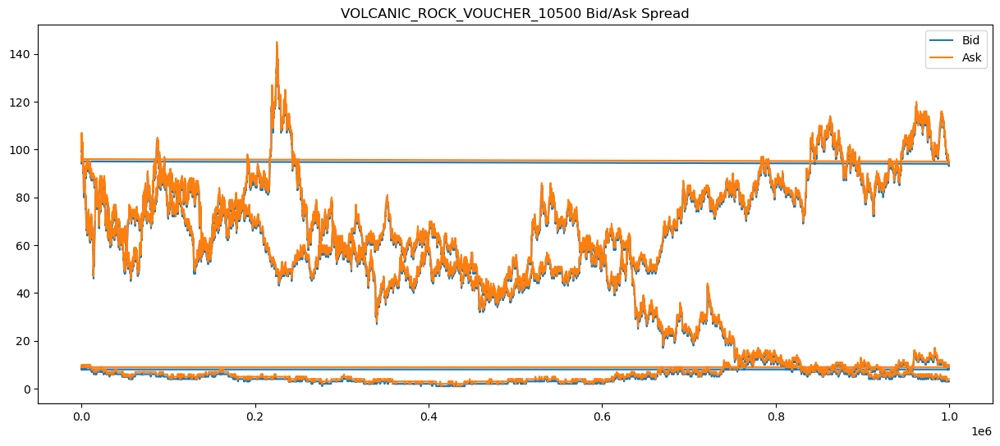

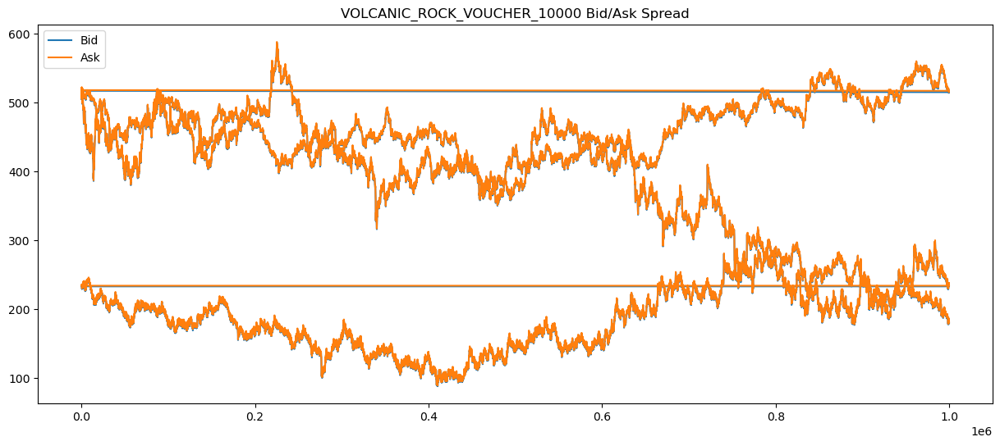

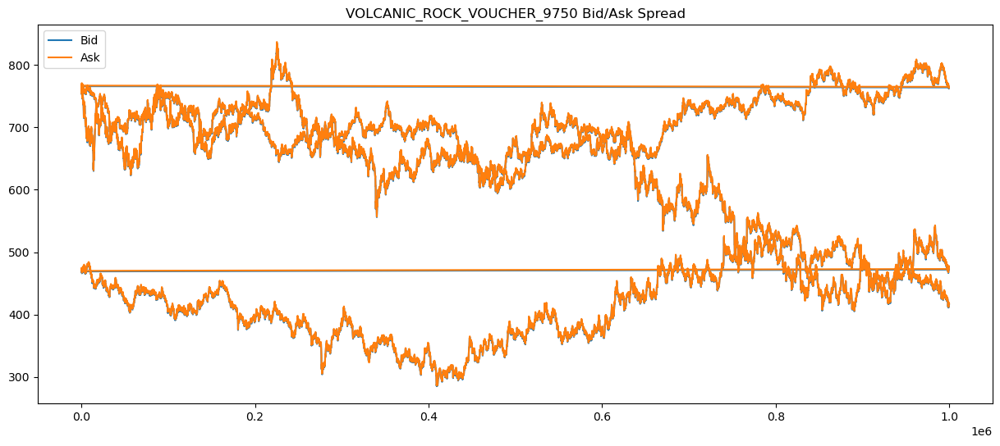

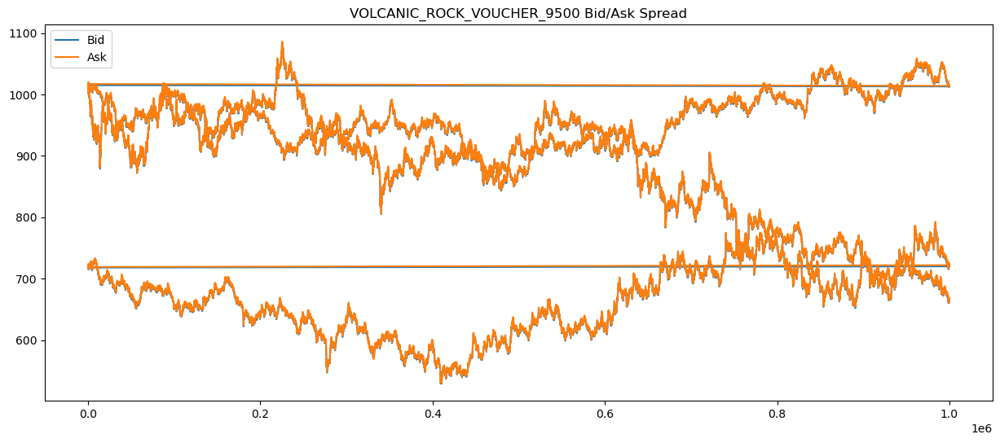

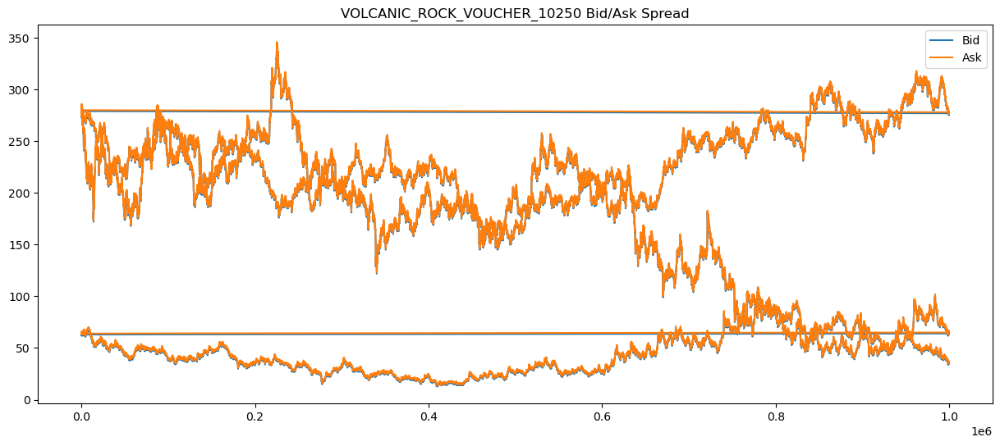

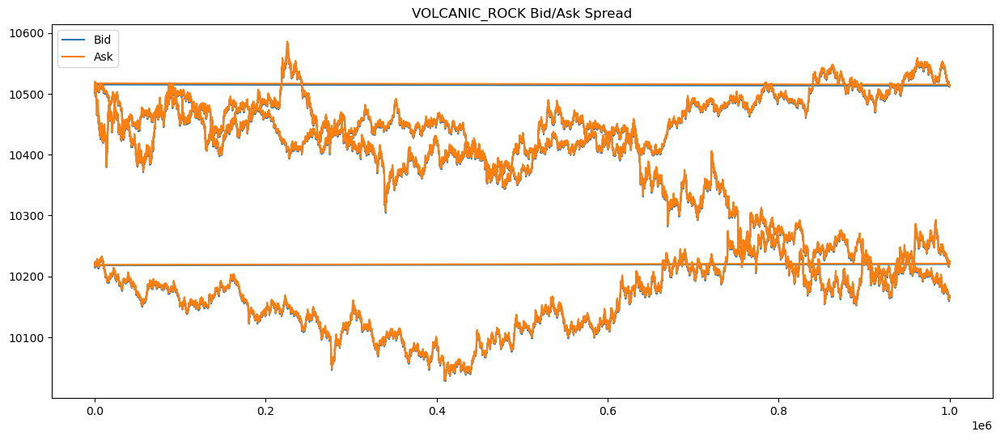

In [56]:
for rock in volcanic_df['product'].unique():
    rock_df = volcanic_df[volcanic_df['product'] == rock]
    
    plt.figure(figsize=(15,6))
    plt.plot(rock_df['timestamp'], rock_df['bid_price_1'], label='Bid')
    plt.plot(rock_df['timestamp'], rock_df['ask_price_1'], label='Ask')
    plt.fill_between(rock_df['timestamp'], rock_df['bid_price_1'], rock_df['ask_price_1'], alpha=0.2)
    plt.title(f'{rock} Bid/Ask Spread')
    plt.legend()
    plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import zscore
import seaborn as sns

p1 = 'VOLCANIC_ROCK_VOUCHER_10500'
p2 = 'VOLCANIC_ROCK_VOUCHER_10000'

p1_df = volcanic_df[volcanic_df['product'] == p1].reset_index(drop=True)
p2_df = volcanic_df[volcanic_df['product'] == p2].reset_index(drop=True)

# Merge on timestamp (assuming same timestamps)
merged = pd.merge(p1_df, p2_df, on='timestamp', suffixes=('_10500', '_10000'))

merged['spread'] = merged['mid_price_10500'] - merged['mid_price_10000']
merged['spread_z'] = zscore(merged['spread'])

plt.figure(figsize=(15,6))
plt.plot(merged['timestamp'], merged['spread'], label='Spread')
plt.plot(merged['timestamp'], merged['spread_z'], label='Z-Score Spread')
plt.axhline(0, color='black', linestyle='--')
plt.axhline(2, color='red', linestyle='--')
plt.axhline(-2, color='green', linestyle='--')
plt.legend()
plt.title('Spread between 10500 and 10000')
plt.show()


Maximum PnL: 600000.00 achieved at maximum buying price 200
Number of turtles bought at optimal price: 5000 out of 10000


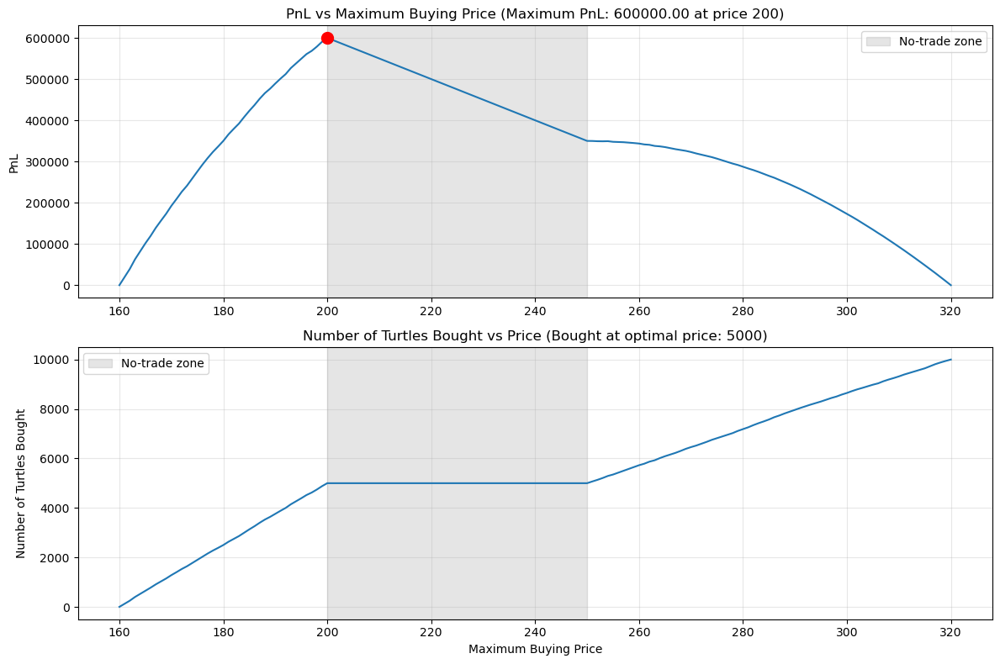

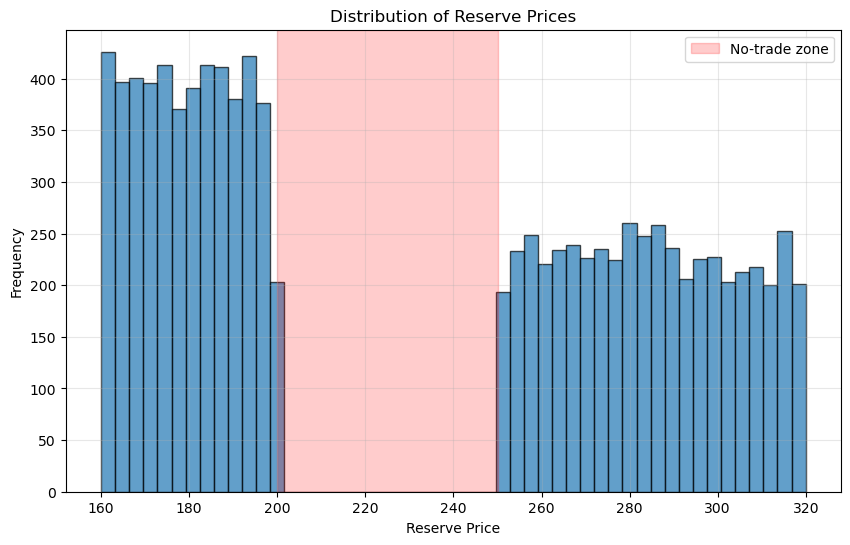


Top 5 buying prices with highest PnL:
Rank | Price | PnL | Turtles Bought
----------------------------------------
1 | 200 | 600000.00 | 5000
2 | 201 | 595000.00 | 5000
3 | 199 | 590601.00 | 4881
4 | 202 | 590000.00 | 5000
5 | 203 | 585000.00 | 5000


In [16]:
import numpy as np
import matplotlib.pyplot as plt

# Generate the reserve prices according to the distribution
np.random.seed(42)  # For reproducibility

# Number of Sea Turtles to simulate
num_turtles = 10000

# Generate uniform distribution between 160-200 and 250-320
lower_range = np.random.uniform(160, 200, num_turtles // 2)
upper_range = np.random.uniform(250, 320, num_turtles // 2)
reserve_prices = np.concatenate([lower_range, upper_range])

# Fixed selling price
selling_price = 320

# Function to calculate PnL at a given buying price
def calculate_pnl(price):
    # We can only buy turtles with reserve prices less than or equal to our offered price
    bought_turtles = reserve_prices[reserve_prices <= price]
    total_cost = len(reserve_prices[reserve_prices <= price])
    # Number of turtles we can buy
    num_bought = len(bought_turtles)
    
    # Total cost to buy these turtles at their reserve prices
    #total_cost = np.sum(bought_turtles)
    
    # Revenue from selling all bought turtles at the fixed price of 320
    revenue = selling_price * num_bought
    
    # PnL = revenue - cost
    pnl = revenue - total_cost * price
    
    return pnl, num_bought

# Simulate all possible offered prices with step 1
prices = range(160, 321)
results = []

for price in prices:
    pnl, num_bought = calculate_pnl(price)
    results.append((price, pnl, num_bought))

# Convert results to numpy array for easier manipulation
results_array = np.array(results)

# Find the price that maximizes PnL
max_pnl_idx = np.argmax(results_array[:, 1])
max_price = results_array[max_pnl_idx, 0]
max_pnl = results_array[max_pnl_idx, 1]
bought_at_max = results_array[max_pnl_idx, 2]

print(f"Maximum PnL: {max_pnl:.2f} achieved at maximum buying price {max_price}")
print(f"Number of turtles bought at optimal price: {bought_at_max} out of {num_turtles}")

# Plotting the results
plt.figure(figsize=(12, 8))

# Plot PnL vs Price
plt.subplot(2, 1, 1)
plt.plot(results_array[:, 0], results_array[:, 1])
plt.scatter([max_price], [max_pnl], color='red', s=100, zorder=5)
plt.grid(True, alpha=0.3)
plt.title(f'PnL vs Maximum Buying Price (Maximum PnL: {max_pnl:.2f} at price {max_price})')
plt.ylabel('PnL')
plt.axvspan(200, 250, alpha=0.2, color='gray', label='No-trade zone')
plt.legend()

# Plot Number of Turtles Bought vs Price
plt.subplot(2, 1, 2)
plt.plot(results_array[:, 0], results_array[:, 2])
plt.grid(True, alpha=0.3)
plt.title(f'Number of Turtles Bought vs Price (Bought at optimal price: {bought_at_max})')
plt.xlabel('Maximum Buying Price')
plt.ylabel('Number of Turtles Bought')
plt.axvspan(200, 250, alpha=0.2, color='gray', label='No-trade zone')
plt.legend()

plt.tight_layout()
plt.show()

# Distribution of reserve prices
plt.figure(figsize=(10, 6))
plt.hist(reserve_prices, bins=50, edgecolor='black', alpha=0.7)
plt.axvspan(200, 250, alpha=0.2, color='red', label='No-trade zone')
plt.title('Distribution of Reserve Prices')
plt.xlabel('Reserve Price')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)
plt.legend()
plt.show()

# Print detailed results for the top 5 prices
sorted_results = results_array[results_array[:, 1].argsort()][::-1]
print("\nTop 5 buying prices with highest PnL:")
print("Rank | Price | PnL | Turtles Bought")
print("-" * 40)
for i in range(5):
    price = sorted_results[i, 0]
    pnl = sorted_results[i, 1]
    bought = sorted_results[i, 2]
    print(f"{i+1} | {price:.0f} | {pnl:.2f} | {bought:.0f}")

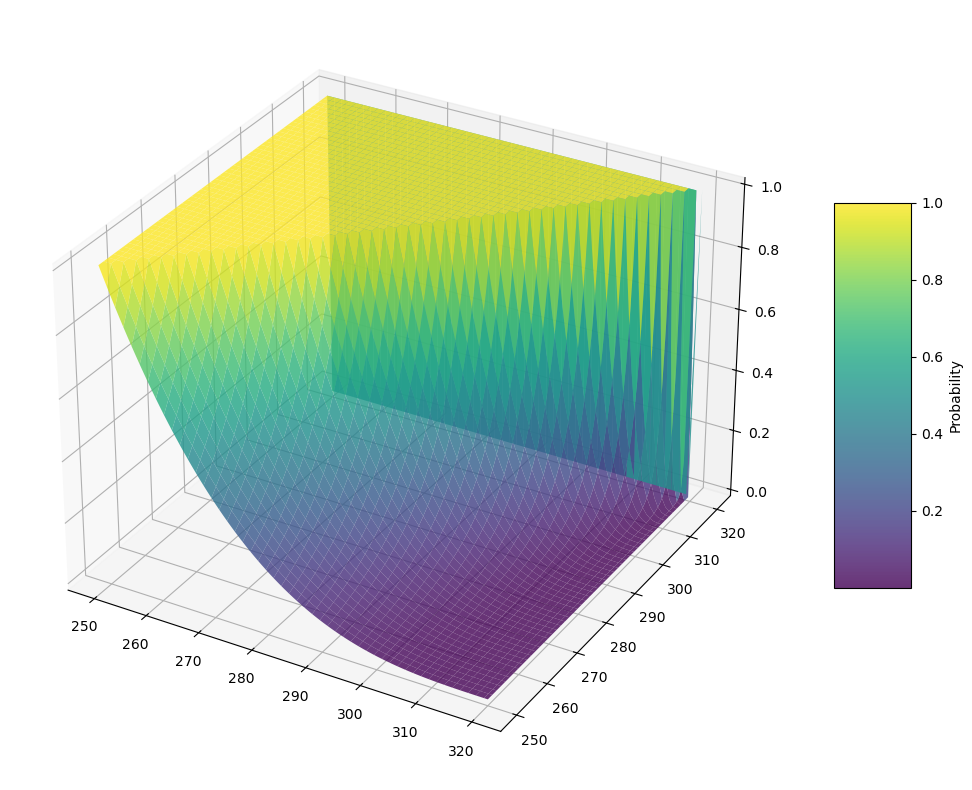

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

# Create a grid of values for average_bid and your_bid
average_bid = np.linspace(250, 320, 100)
your_bid = np.linspace(250, 320, 100)
average_bid_grid, your_bid_grid = np.meshgrid(average_bid, your_bid)

# Calculate the probability function
# Adding a small epsilon to avoid division by zero when your_bid = 320
epsilon = 1e-10
p = ((320 - average_bid_grid) / (320 - your_bid_grid + epsilon))**3

# Handle the case where your_bid = 320 (set to 1 when average_bid = 320, 0 otherwise)
p[your_bid_grid >= 320 - epsilon] = np.where(
    average_bid_grid[your_bid_grid >= 320 - epsilon] >= 320 - epsilon, 
    1, 
    0
)

# Cap values at 1 (for cases where your_bid < average_bid)
p = np.minimum(p, 1)

# Create a 3D plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# Create the 3D surface plot
surf = ax.plot_surface(average_bid_grid, your_bid_grid, p, 
                       cmap=cm.viridis, 
                       linewidth=0, 
                       antialiased=True,
                       alpha=0.8)

# Add a color bar
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5, label='Probability')

# Add labels and ti

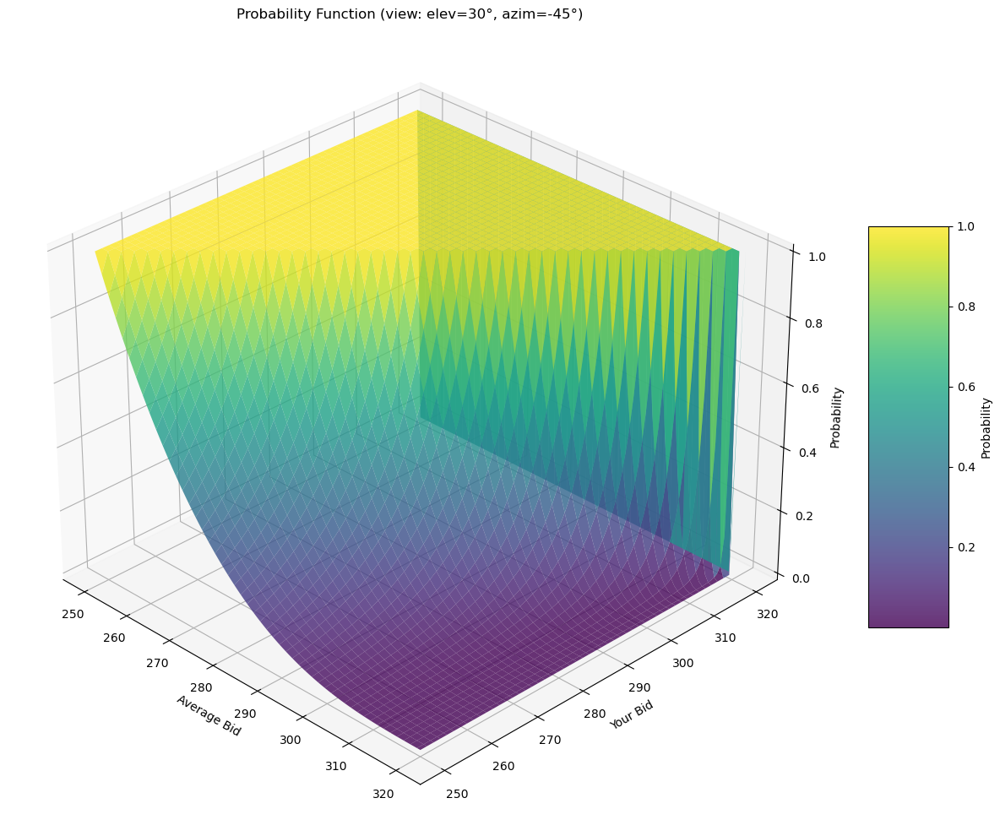

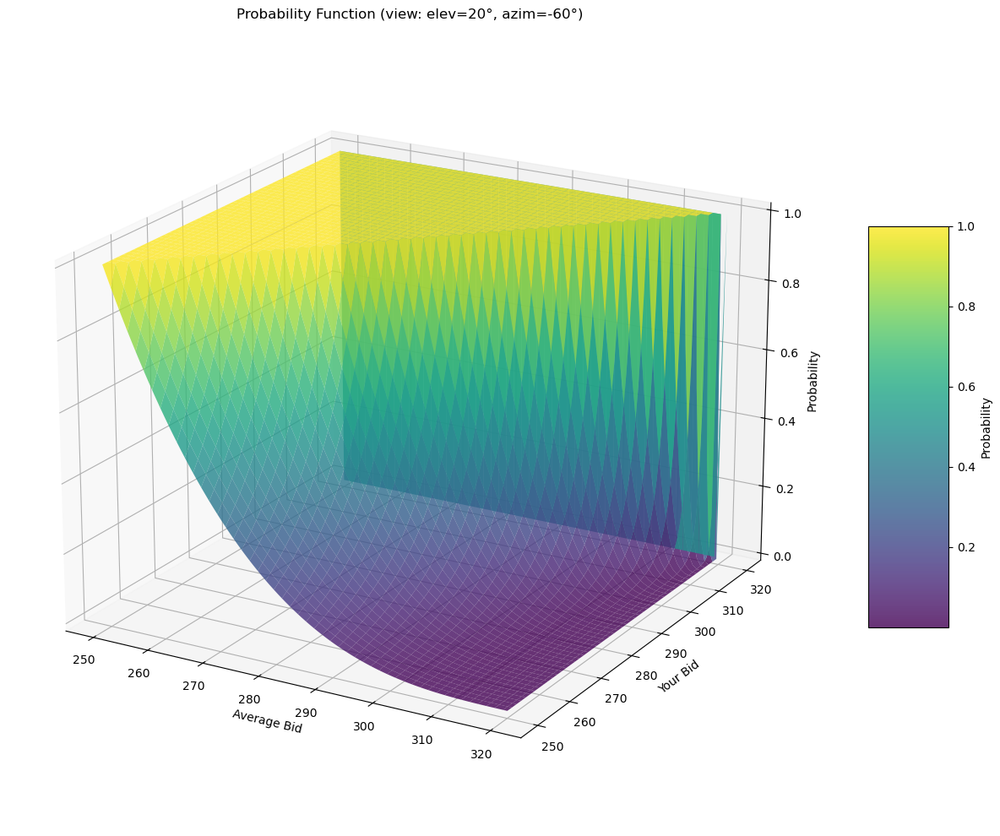

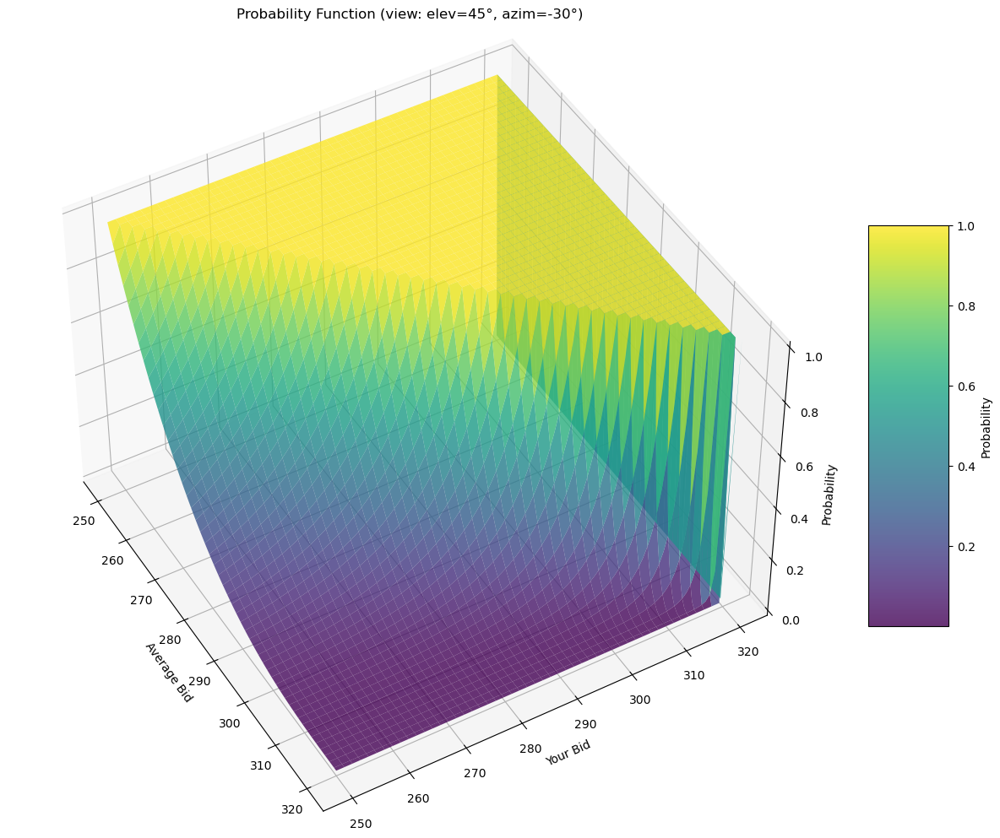

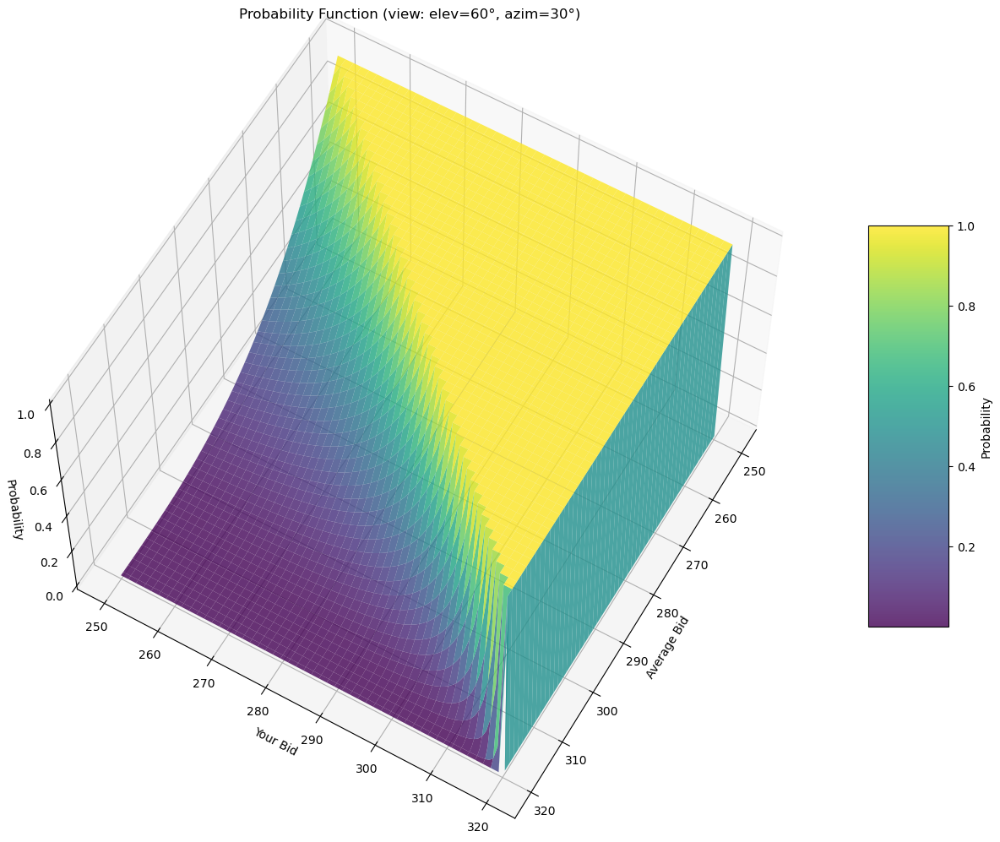

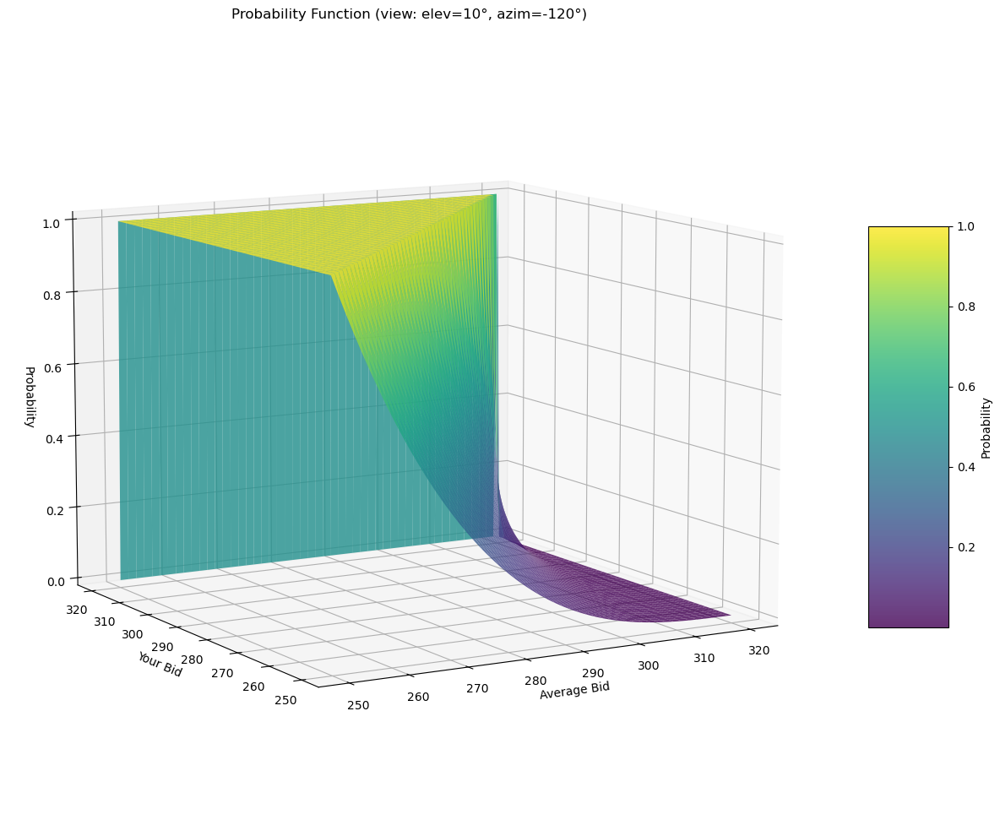

"\nfrom ipywidgets import interact, widgets\n\n@interact(\n    elevation=widgets.IntSlider(min=0, max=90, step=5, value=30, description='Elevation:'),\n    azimuth=widgets.IntSlider(min=-180, max=180, step=10, value=-45, description='Azimuth:')\n)\ndef update_view(elevation, azimuth):\n    fig = create_3d_plot(elevation, azimuth)\n    plt.show()\n"

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

# Create a grid of values for average_bid and your_bid
average_bid = np.linspace(250, 320, 100)
your_bid = np.linspace(250, 320, 100)
average_bid_grid, your_bid_grid = np.meshgrid(average_bid, your_bid)

# Calculate the probability function
# Adding a small epsilon to avoid division by zero when your_bid = 320
epsilon = 1e-10
p = ((320 - average_bid_grid) / (320 - your_bid_grid + epsilon))**3

# Handle the case where your_bid = 320 (set to 1 when average_bid = 320, 0 otherwise)
p[your_bid_grid >= 320 - epsilon] = np.where(
    average_bid_grid[your_bid_grid >= 320 - epsilon] >= 320 - epsilon, 
    1, 
    0
)

# Cap values at 1 (for cases where your_bid < average_bid)
p = np.minimum(p, 1)

# Function to create the 3D plot with specified viewing angles
def create_3d_plot(elev, azim):
    fig = plt.figure(figsize=(14, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Create the 3D surface plot
    surf = ax.plot_surface(average_bid_grid, your_bid_grid, p, 
                           cmap=cm.viridis, 
                           linewidth=0, 
                           antialiased=True,
                           alpha=0.8)
    
    # Add a color bar
    fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5, label='Probability')
    
    # Add labels and title
    ax.set_xlabel('Average Bid')
    ax.set_ylabel('Your Bid')
    ax.set_zlabel('Probability')
    ax.set_title(f'Probability Function (view: elev={elev}°, azim={azim}°)')
    
    # Set the viewing angle
    ax.view_init(elev=elev, azim=azim)
    
    plt.tight_layout()
    return fig

# Create multiple plots with different viewing angles
angles = [
    (30, -45),  # Default angle used previously
    (20, -60),  # Lower elevation, more rotated
    (45, -30),  # Higher elevation, less rotated
    (60, 30),   # High elevation, opposite side
    (10, -120)  # Low elevation, different angle
]

# Display each angle in a separate plot
for elev, azim in angles:
    fig = create_3d_plot(elev, azim)
    plt.show()

# Interactive angle selection demo
# Uncomment the code below to run interactively
"""
from ipywidgets import interact, widgets

@interact(
    elevation=widgets.IntSlider(min=0, max=90, step=5, value=30, description='Elevation:'),
    azimuth=widgets.IntSlider(min=-180, max=180, step=10, value=-45, description='Azimuth:')
)
def update_view(elevation, azimuth):
    fig = create_3d_plot(elevation, azimuth)
    plt.show()
"""

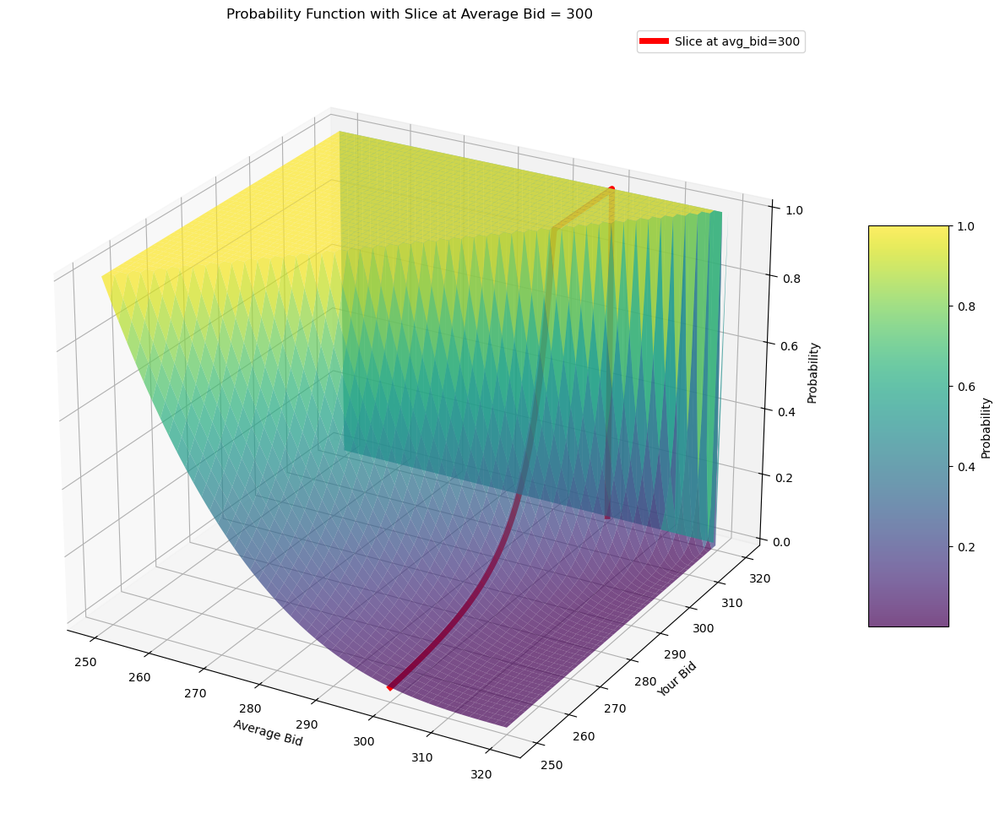

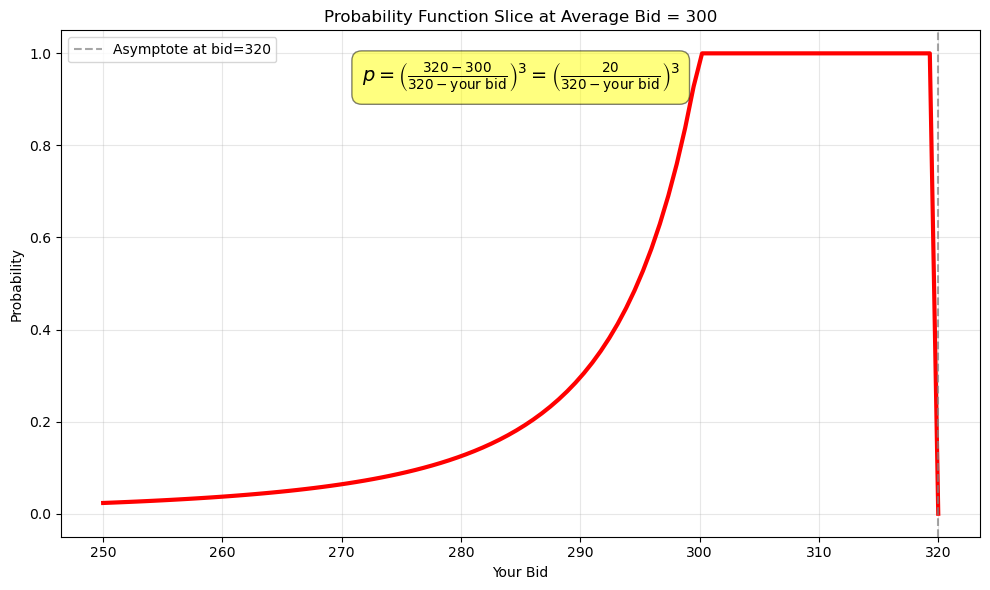

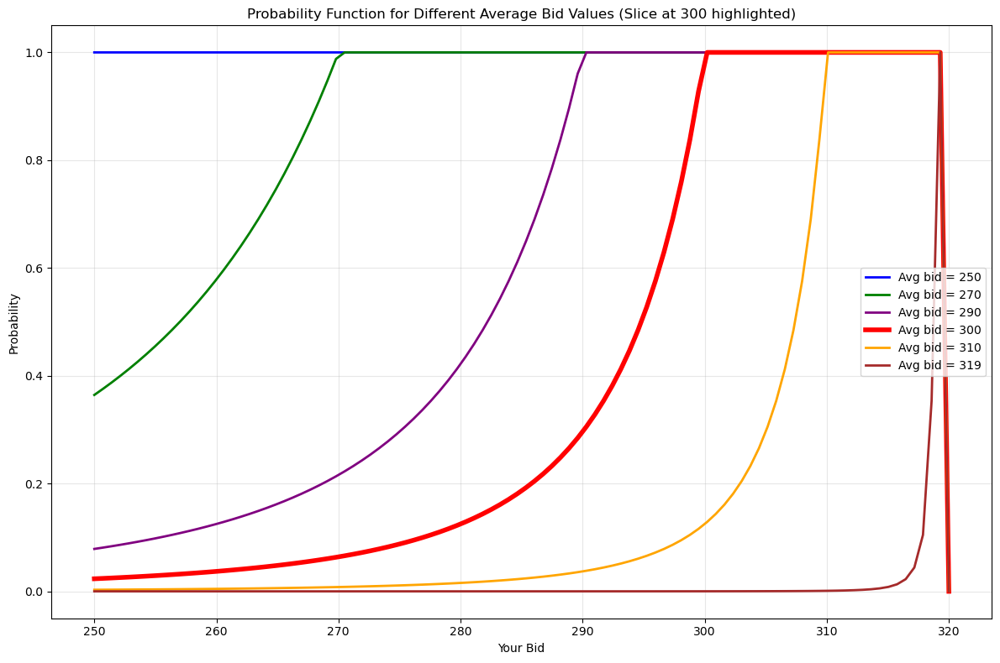

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D

# Create a grid of values for average_bid and your_bid
average_bid = np.linspace(250, 320, 100)
your_bid = np.linspace(250, 320, 100)
average_bid_grid, your_bid_grid = np.meshgrid(average_bid, your_bid)

# Calculate the probability function
# Adding a small epsilon to avoid division by zero when your_bid = 320
epsilon = 1e-10
p = ((320 - average_bid_grid) / (320 - your_bid_grid + epsilon))**3

# Handle the case where your_bid = 320 (set to 1 when average_bid = 320, 0 otherwise)
p[your_bid_grid >= 320 - epsilon] = np.where(
    average_bid_grid[your_bid_grid >= 320 - epsilon] >= 320 - epsilon, 
    1, 
    0
)

# Cap values at 1 (for cases where your_bid < average_bid)
p = np.minimum(p, 1)

# Create a 3D plot
fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

# Create the 3D surface plot with some transparency
surf = ax.plot_surface(average_bid_grid, your_bid_grid, p, 
                     cmap=cm.viridis, 
                     linewidth=0, 
                     antialiased=True,
                     alpha=0.7)  # Make the main surface semi-transparent

# Add a color bar for the main surface
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5, label='Probability')

# Create the slice at average_bid = 300
slice_idx = np.abs(average_bid - 300).argmin()  # Find index closest to 300
slice_avg_bid = np.ones_like(your_bid) * 300
slice_your_bid = your_bid
slice_p = ((320 - 300) / (320 - slice_your_bid + epsilon))**3

# Handle edge cases for the slice
slice_p[slice_your_bid >= 320 - epsilon] = 0  # Since average_bid (300) < 320
slice_p = np.minimum(slice_p, 1)  # Cap at 1

# Plot the slice with a different color and thicker line
ax.plot(slice_avg_bid, slice_your_bid, slice_p, 
        color='red', linewidth=5, label='Slice at avg_bid=300')

# Add labels and title
ax.set_xlabel('Average Bid')
ax.set_ylabel('Your Bid')
ax.set_zlabel('Probability')
ax.set_title('Probability Function with Slice at Average Bid = 300')

# Set the viewing angles for better visibility of the slice
ax.view_init(elev=25, azim=-60)

# Add legend
ax.legend()

plt.tight_layout()
plt.show()

# Also create a 2D view of just the slice
plt.figure(figsize=(10, 6))
plt.plot(slice_your_bid, slice_p, 'r-', linewidth=3)
plt.grid(True, alpha=0.3)
plt.xlabel('Your Bid')
plt.ylabel('Probability')
plt.title('Probability Function Slice at Average Bid = 300')

# Add formula as text
formula_text = r'$p = \left(\frac{320 - 300}{320 - \text{your bid}}\right)^3 = \left(\frac{20}{320 - \text{your bid}}\right)^3$'
plt.annotate(formula_text, xy=(0.5, 0.9), xycoords='axes fraction', 
             bbox=dict(boxstyle="round,pad=0.5", fc="yellow", alpha=0.5),
             ha='center', fontsize=14)

# Show vertical asymptote at your_bid = 320
plt.axvline(x=320, color='gray', linestyle='--', alpha=0.7, label='Asymptote at bid=320')
plt.legend()

plt.tight_layout()
plt.show()

# Also create a visualization showing multiple slices
plt.figure(figsize=(12, 8))

# Select specific average_bid values
selected_avg_bids = [250, 270, 290, 300, 310, 319]
colors = ['blue', 'green', 'purple', 'red', 'orange', 'brown']
line_styles = ['-', '-', '-', '-', '-', '-']
line_widths = [2, 2, 2, 4, 2, 2]  # Make the 300 line thicker

for avg_bid, color, ls, lw in zip(selected_avg_bids, colors, line_styles, line_widths):
    # Calculate probability for this average_bid
    prob = ((320 - avg_bid) / (320 - your_bid + epsilon))**3
    
    # Handle your_bid = 320
    prob[your_bid >= 320 - epsilon] = 0 if avg_bid < 320 - epsilon else 1
    
    # Cap values at 1
    prob = np.minimum(prob, 1)
    
    plt.plot(your_bid, prob, label=f'Avg bid = {avg_bid}', color=color, 
             linestyle=ls, linewidth=lw)

plt.grid(True, alpha=0.3)
plt.xlabel('Your Bid')
plt.ylabel('Probability')
plt.title('Probability Function for Different Average Bid Values (Slice at 300 highlighted)')
plt.legend()
plt.tight_layout()
plt.show()

In [102]:
vol_rock = df[df['product'].str.contains('VOLCANIC_ROCK')]

In [103]:
vol_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,19,NaN,NaN,NaN,NaN,99.5,0.0
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,19,NaN,NaN,NaN,NaN,505.5,0.0
6,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,19,NaN,NaN,NaN,NaN,754.5,0.0
9,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,19,NaN,NaN,NaN,NaN,1003.5,0.0
11,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,19,NaN,NaN,NaN,NaN,273.5,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419987,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,20,NaN,NaN,NaN,NaN,3.5,0.0
419990,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,20,NaN,NaN,NaN,NaN,36.5,0.0
419994,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,20,NaN,NaN,NaN,NaN,180.5,0.0
419996,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,20,NaN,NaN,NaN,NaN,417.5,0.0


In [104]:
vol_rock['V'] = (vol_rock['bid_price_1'] + vol_rock['ask_price_1']) / 2

/var/folders/gh/dfjmmnfn63s_k8hfzrv1t9m40000gn/T/ipykernel_36365/3336803214.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vol_rock['V'] = (vol_rock['bid_price_1'] + vol_rock['ask_price_1']) / 2


In [105]:
vol_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,V
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,19,NaN,NaN,NaN,NaN,99.5,0.0,99.5
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,19,NaN,NaN,NaN,NaN,505.5,0.0,505.5
6,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,19,NaN,NaN,NaN,NaN,754.5,0.0,754.5
9,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,19,NaN,NaN,NaN,NaN,1003.5,0.0,1003.5
11,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,19,NaN,NaN,NaN,NaN,273.5,0.0,273.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419987,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,20,NaN,NaN,NaN,NaN,3.5,0.0,3.5
419990,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,20,NaN,NaN,NaN,NaN,36.5,0.0,36.5
419994,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,20,NaN,NaN,NaN,NaN,180.5,0.0,180.5
419996,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,20,NaN,NaN,NaN,NaN,417.5,0.0,417.5


In [106]:
vol_rock['actual_time'] = vol_rock['day'] * 1000000 + vol_rock['timestamp']

/var/folders/gh/dfjmmnfn63s_k8hfzrv1t9m40000gn/T/ipykernel_36365/874192142.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vol_rock['actual_time'] = vol_rock['day'] * 1000000 + vol_rock['timestamp']


In [107]:
vol_rock['tte'] = 7000000 - vol_rock['actual_time']

/var/folders/gh/dfjmmnfn63s_k8hfzrv1t9m40000gn/T/ipykernel_36365/2205163482.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vol_rock['tte'] = 7000000 - vol_rock['actual_time']


In [108]:
vol_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,V,actual_time,tte
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,19,NaN,NaN,NaN,NaN,99.5,0.0,99.5,0,7000000
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,19,NaN,NaN,NaN,NaN,505.5,0.0,505.5,0,7000000
6,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,19,NaN,NaN,NaN,NaN,754.5,0.0,754.5,0,7000000
9,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,19,NaN,NaN,NaN,NaN,1003.5,0.0,1003.5,0,7000000
11,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,19,NaN,NaN,NaN,NaN,273.5,0.0,273.5,0,7000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419987,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,20,NaN,NaN,NaN,NaN,3.5,0.0,3.5,2999900,4000100
419990,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,20,NaN,NaN,NaN,NaN,36.5,0.0,36.5,2999900,4000100
419994,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,20,NaN,NaN,NaN,NaN,180.5,0.0,180.5,2999900,4000100
419996,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,20,NaN,NaN,NaN,NaN,417.5,0.0,417.5,2999900,4000100


In [109]:
vol_rock['tte_part'] = vol_rock['tte'] / 7000000

/var/folders/gh/dfjmmnfn63s_k8hfzrv1t9m40000gn/T/ipykernel_36365/2548578191.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vol_rock['tte_part'] = vol_rock['tte'] / 7000000


In [110]:
vol_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,V,actual_time,tte,tte_part
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,NaN,NaN,NaN,NaN,99.5,0.0,99.5,0,7000000,1.000000
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,NaN,NaN,NaN,NaN,505.5,0.0,505.5,0,7000000,1.000000
6,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,NaN,NaN,NaN,NaN,754.5,0.0,754.5,0,7000000,1.000000
9,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,NaN,NaN,NaN,NaN,1003.5,0.0,1003.5,0,7000000,1.000000
11,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,NaN,NaN,NaN,NaN,273.5,0.0,273.5,0,7000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419987,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,...,NaN,NaN,NaN,NaN,3.5,0.0,3.5,2999900,4000100,0.571443
419990,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,...,NaN,NaN,NaN,NaN,36.5,0.0,36.5,2999900,4000100,0.571443
419994,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,...,NaN,NaN,NaN,NaN,180.5,0.0,180.5,2999900,4000100,0.571443
419996,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,...,NaN,NaN,NaN,NaN,417.5,0.0,417.5,2999900,4000100,0.571443


In [111]:
volcanic_rock_df = vol_rock[vol_rock['product'] == 'VOLCANIC_ROCK']

option_rock = vol_rock[vol_rock['product'].str.contains('VOLCANIC_ROCK_VOUCHER_')]

In [112]:
volcanic_rock_df

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,V,actual_time,tte,tte_part
13,0,0,VOLCANIC_ROCK,10502.0,205.0,NaN,NaN,NaN,NaN,10504,...,10505.0,59.0,NaN,NaN,10503.0,0.0,10503.0,0,7000000,1.000000
21,0,100,VOLCANIC_ROCK,10509.0,192.0,NaN,NaN,NaN,NaN,10511,...,10512.0,70.0,NaN,NaN,10510.0,0.0,10510.0,100,6999900,0.999986
31,0,200,VOLCANIC_ROCK,10512.0,167.0,NaN,NaN,NaN,NaN,10514,...,10515.0,58.0,NaN,NaN,10513.0,0.0,10513.0,200,6999800,0.999971
55,0,300,VOLCANIC_ROCK,10517.0,118.0,10516.0,68.0,NaN,NaN,10518,...,10519.0,68.0,NaN,NaN,10517.5,0.0,10517.5,300,6999700,0.999957
60,0,400,VOLCANIC_ROCK,10509.0,128.0,10508.0,73.0,NaN,NaN,10510,...,10511.0,73.0,NaN,NaN,10509.5,0.0,10509.5,400,6999600,0.999943
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419936,2,999500,VOLCANIC_ROCK,10167.0,110.0,10166.0,51.0,NaN,NaN,10169,...,NaN,NaN,NaN,NaN,10168.0,0.0,10168.0,2999500,4000500,0.571500
419945,2,999600,VOLCANIC_ROCK,10166.0,161.0,NaN,NaN,NaN,NaN,10168,...,10169.0,60.0,NaN,NaN,10167.0,0.0,10167.0,2999600,4000400,0.571486
419965,2,999700,VOLCANIC_ROCK,10166.0,143.0,10165.0,51.0,NaN,NaN,10168,...,NaN,NaN,NaN,NaN,10167.0,0.0,10167.0,2999700,4000300,0.571471
419984,2,999800,VOLCANIC_ROCK,10167.0,119.0,10166.0,57.0,NaN,NaN,10168,...,10169.0,57.0,NaN,NaN,10167.5,0.0,10167.5,2999800,4000200,0.571457


In [113]:
option_rock.head(5)

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,V,actual_time,tte,tte_part
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,NaN,NaN,NaN,NaN,99.5,0.0,99.5,0,7000000,1.0
4,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,NaN,NaN,NaN,NaN,505.5,0.0,505.5,0,7000000,1.0
6,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,NaN,NaN,NaN,NaN,754.5,0.0,754.5,0,7000000,1.0
9,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,NaN,NaN,NaN,NaN,1003.5,0.0,1003.5,0,7000000,1.0
11,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,NaN,NaN,NaN,NaN,273.5,0.0,273.5,0,7000000,1.0


In [114]:
# Merge option_rock with volcanic_rock_df on tte_part to get the mid_price as S
option_rock = option_rock.merge(
    volcanic_rock_df[['tte_part', 'mid_price']],
    on='tte_part',
    how='left'
)

# Rename the mid_price column to S
option_rock.rename(columns={'mid_price_x': 'S'}, inplace=True)

In [116]:
option_rock
option_rock.rename(columns={'mid_price_y': 'S'}, inplace=True)

In [117]:
option_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_volume_2,ask_price_3,ask_volume_3,mid_price_x,profit_and_loss,V,actual_time,tte,tte_part,S
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,NaN,NaN,NaN,99.5,0.0,99.5,0,7000000,1.000000,10503.0
1,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,NaN,NaN,NaN,505.5,0.0,505.5,0,7000000,1.000000,10503.0
2,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,NaN,NaN,NaN,754.5,0.0,754.5,0,7000000,1.000000,10503.0
3,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,NaN,NaN,NaN,1003.5,0.0,1003.5,0,7000000,1.000000,10503.0
4,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,NaN,NaN,NaN,273.5,0.0,273.5,0,7000000,1.000000,10503.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149995,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,...,NaN,NaN,NaN,3.5,0.0,3.5,2999900,4000100,0.571443,10166.5
149996,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,...,NaN,NaN,NaN,36.5,0.0,36.5,2999900,4000100,0.571443,10166.5
149997,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,...,NaN,NaN,NaN,180.5,0.0,180.5,2999900,4000100,0.571443,10166.5
149998,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,...,NaN,NaN,NaN,417.5,0.0,417.5,2999900,4000100,0.571443,10166.5


In [118]:
# Extract strike price K from the product column
def extract_strike(product):
    return int(product.split("_")[-1])

option_rock['K'] = option_rock['product'].apply(extract_strike)


In [119]:
option_rock

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_price_3,ask_volume_3,mid_price_x,profit_and_loss,V,actual_time,tte,tte_part,S,K
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,NaN,NaN,99.5,0.0,99.5,0,7000000,1.000000,10503.0,10500
1,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,NaN,NaN,505.5,0.0,505.5,0,7000000,1.000000,10503.0,10000
2,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,NaN,NaN,754.5,0.0,754.5,0,7000000,1.000000,10503.0,9750
3,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,NaN,NaN,1003.5,0.0,1003.5,0,7000000,1.000000,10503.0,9500
4,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,NaN,NaN,273.5,0.0,273.5,0,7000000,1.000000,10503.0,10250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
149995,2,999900,VOLCANIC_ROCK_VOUCHER_10500,3.0,20.0,NaN,NaN,NaN,NaN,4,...,NaN,NaN,3.5,0.0,3.5,2999900,4000100,0.571443,10166.5,10500
149996,2,999900,VOLCANIC_ROCK_VOUCHER_10250,36.0,20.0,NaN,NaN,NaN,NaN,37,...,NaN,NaN,36.5,0.0,36.5,2999900,4000100,0.571443,10166.5,10250
149997,2,999900,VOLCANIC_ROCK_VOUCHER_10000,180.0,20.0,NaN,NaN,NaN,NaN,181,...,NaN,NaN,180.5,0.0,180.5,2999900,4000100,0.571443,10166.5,10000
149998,2,999900,VOLCANIC_ROCK_VOUCHER_9750,417.0,20.0,NaN,NaN,NaN,NaN,418,...,NaN,NaN,417.5,0.0,417.5,2999900,4000100,0.571443,10166.5,9750


In [120]:
# Compute m_t
option_rock['m_t'] = np.log(option_rock['K'] / option_rock['S']) / np.sqrt(option_rock['tte_part'])

In [121]:
import numpy as np
from scipy.stats import norm

In [123]:
option_rock.head(5)

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,ask_volume_3,mid_price_x,profit_and_loss,V,actual_time,tte,tte_part,S,K,m_t
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,NaN,99.5,0.0,99.5,0,7000000,1.0,10503.0,10500,-0.000286
1,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,NaN,505.5,0.0,505.5,0,7000000,1.0,10503.0,10000,-0.049076
2,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,NaN,754.5,0.0,754.5,0,7000000,1.0,10503.0,9750,-0.074394
3,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,NaN,1003.5,0.0,1003.5,0,7000000,1.0,10503.0,9500,-0.100369
4,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,NaN,273.5,0.0,273.5,0,7000000,1.0,10503.0,10250,-0.024383


In [129]:
import numpy as np
import pandas as pd


def black_scholes_call(S, K, T, r, sigma):
    """
    Calculate the price of a European call option using Black-Scholes formula.
    
    Parameters:
    S: Underlying asset price
    K: Strike price
    T: Time to expiration (in years)
    r: Risk-free interest rate (annual rate, expressed as a decimal)
    sigma: Volatility of the underlying asset (annual, expressed as a decimal)
    
    Returns:
    Call option price
    """
    if T <= 0:
        # For expired options, return max(0, S-K)
        return max(0, S-K)
    
    if sigma <= 0:
        # Handle invalid volatility
        return max(0, S-K * np.exp(-r*T))
    
    d1 = (np.log(S/K) + (r + 0.5 * sigma**2) * T) / (sigma * np.sqrt(T))
    d2 = d1 - sigma * np.sqrt(T)
    
    return S * norm.cdf(d1) - K * np.exp(-r * T) * norm.cdf(d2)

def implied_volatility_newton(S, V, K, T, r=0.0, initial_guess=0.3, 
                             precision=1e-8, max_iterations=100):
    """
    Calculate implied volatility using Newton-Raphson method.
    
    Parameters:
    S: Underlying asset price
    V: Observed call option price
    K: Strike price
    T: Time to expiration (in years)
    r: Risk-free interest rate (default: 0.0)
    initial_guess: Initial guess for volatility (default: 0.3)
    precision: Desired precision (default: 1e-8)
    max_iterations: Maximum number of iterations (default: 100)
    
    Returns:
    Implied volatility (sigma)
    """
    # Basic error checking
    if V <= 0:
        return 0  # Option has no value
    
    if V >= S:
        return float('inf')  # Option price exceeds underlying value
    
    intrinsic = max(0, S - K * np.exp(-r * T))
    if V < intrinsic:
        return 0  # Option price below intrinsic value
    
    if T <= 0:
        return float('nan')  # Expired option
    
    # Initial guess
    sigma = initial_guess
    
    # Calculate vega (derivative of price with respect to volatility)
    def vega(sigma):
        d1 = (np.log(S/K) + (r + 0.5 * sigma**2) * T) / (sigma * np.sqrt(T))
        return S * np.sqrt(T) * norm.pdf(d1)
    
    for i in range(max_iterations):
        price = black_scholes_call(S, K, T, r, sigma)
        price_diff = price - V
        
        if abs(price_diff) < precision:
            return sigma
        
        v = vega(sigma)
        if abs(v) < 1e-10:
            # Avoid division by zero
            return float('nan')
        
        # Newton-Raphson update
        sigma = sigma - price_diff / v
        
        # Handle sigma going negative or too high
        if sigma <= 0:
            sigma = 0.001
        elif sigma > 50:
            return float('nan')
    
    # If didn't converge within max iterations
    return float('nan')

def calculate_implied_vol_for_dataframe(df):
    """
    Calculate implied volatility for each row in the dataframe and add to 'v' column.
    
    Parameters:
    df: DataFrame with columns 'S' (underlying price), 'V' (option price), 
        'K' (strike price), and 'tte_part' (time to expiration)
    
    Returns:
    DataFrame with added 'v' column containing the implied volatility
    """
    # Create a copy of the dataframe to avoid modifying the original
    result_df = df.copy()
    
    # Add empty column for implied volatility
    result_df['v'] = np.nan
    
    # Counter for progress tracking
    total_rows = len(result_df)
    processed = 0
    error_count = 0
    
    # Process each row
    for idx, row in result_df.iterrows():
        try:
            # Extract values from row
            S = row['S']  # Underlying price
            V = row['V']  # Call option price
            K = row['K']  # Strike price
            T = row['tte_part']  # Time to expiration
            r = 0.0  # Risk-free interest rate set to 0 as required
            
            # Calculate implied volatility
            iv = implied_volatility_newton(S, V, K, T, r)
            
            # Store in dataframe
            result_df.at[idx, 'v'] = iv
            
        except Exception as e:
            # Handle errors gracefully
            error_count += 1
            result_df.at[idx, 'v'] = np.nan
        
        # Update progress counter
        processed += 1
        if processed % 1000 == 0:
            print(f"Processed {processed}/{total_rows} rows ({processed/total_rows*100:.1f}%)")
    
    if error_count > 0:
        print(f"Note: Could not calculate IV for {error_count} rows due to errors or invalid data")
    
    return result_df

# Example usage with a synthetic dataframe for demonstration
def create_sample_data():
    # Create sample data
    data = {
        'S': [100, 100, 100, 100, 100],  # Underlying price
        'V': [10, 5, 15, 2, 30],         # Option price
        'K': [100, 110, 90, 120, 70],    # Strike price
        'tte_part': [1.0, 0.5, 0.5, 0.25, 0.5]  # Time to expiration
    }
    return pd.DataFrame(data)

result = calculate_implied_vol_for_dataframe(option_rock)
print("\nSample DataFrame after adding implied volatility:")
print(result)

# Verification step
print("\nVerification - Recalculating option prices using the calculated IV:")
for idx, row in result.iterrows():
    S = row['S']
    K = row['K']
    T = row['tte_part']
    iv = row['v']
    calculated_price = black_scholes_call(S, K, T, 0.0, iv)
    original_price = row['V']
    print(f"Row {idx}: Original price = {original_price:.6f}, Calculated price = {calculated_price:.6f}, Diff = {abs(original_price-calculated_price):.9f}")

# Instructions for processing your actual dataframe
print("\nTo process your actual option_rock dataframe, use:")
print("option_rock = calculate_implied_vol_for_dataframe(option_rock)")

Processed 1000/150000 rows (0.7%)
Processed 2000/150000 rows (1.3%)
Processed 3000/150000 rows (2.0%)
Processed 4000/150000 rows (2.7%)
Processed 5000/150000 rows (3.3%)
Processed 6000/150000 rows (4.0%)
Processed 7000/150000 rows (4.7%)
Processed 8000/150000 rows (5.3%)
Processed 9000/150000 rows (6.0%)
Processed 10000/150000 rows (6.7%)
Processed 11000/150000 rows (7.3%)
Processed 12000/150000 rows (8.0%)
Processed 13000/150000 rows (8.7%)
Processed 14000/150000 rows (9.3%)
Processed 15000/150000 rows (10.0%)
Processed 16000/150000 rows (10.7%)
Processed 17000/150000 rows (11.3%)
Processed 18000/150000 rows (12.0%)
Processed 19000/150000 rows (12.7%)
Processed 20000/150000 rows (13.3%)
Processed 21000/150000 rows (14.0%)
Processed 22000/150000 rows (14.7%)
Processed 23000/150000 rows (15.3%)
Processed 24000/150000 rows (16.0%)
Processed 25000/150000 rows (16.7%)
Processed 26000/150000 rows (17.3%)
Processed 27000/150000 rows (18.0%)
Processed 28000/150000 rows (18.7%)
Processed 29000

In [130]:
result.head(5)

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,...,mid_price_x,profit_and_loss,V,actual_time,tte,tte_part,S,K,m_t,v
0,0,0,VOLCANIC_ROCK_VOUCHER_10500,99.0,19.0,NaN,NaN,NaN,NaN,100,...,99.5,0.0,99.5,0,7000000,1.0,10503.0,10500,-0.000286,0.023391
1,0,0,VOLCANIC_ROCK_VOUCHER_10000,505.0,19.0,NaN,NaN,NaN,NaN,506,...,505.5,0.0,505.5,0,7000000,1.0,10503.0,10000,-0.049076,0.025165
2,0,0,VOLCANIC_ROCK_VOUCHER_9750,754.0,19.0,NaN,NaN,NaN,NaN,755,...,754.5,0.0,754.5,0,7000000,1.0,10503.0,9750,-0.074394,0.033318
3,0,0,VOLCANIC_ROCK_VOUCHER_9500,1003.0,19.0,NaN,NaN,NaN,NaN,1004,...,1003.5,0.0,1003.5,0,7000000,1.0,10503.0,9500,-0.100369,0.038108
4,0,0,VOLCANIC_ROCK_VOUCHER_10250,273.0,19.0,NaN,NaN,NaN,NaN,274,...,273.5,0.0,273.5,0,7000000,1.0,10503.0,10250,-0.024383,0.024152


In [131]:
import numpy as np
from scipy.optimize import curve_fit

import matplotlib.pyplot as plt

# Define a parabolic function for fitting
def parabolic(x, a, b, c):
    return a * x**2 + b * x + c

# Group the data by 'tte_part' (time to expiration)
grouped = result.groupby('actual_time')
grouped = {tte: group for tte, group in grouped if tte in sorted(grouped.groups.keys())[:3]}
# Iterate over each group and plot
for tte, group in grouped:
    # Extract m_t and v_t
    m_t = group['m_t']
    v_t = group['v']
    
    # Fit the parabolic curve
    try:
        popt, _ = curve_fit(parabolic, m_t, v_t)
        fitted_v_t = parabolic(m_t, *popt)
    except Exception as e:
        print(f"Could not fit curve for tte_part={tte}: {e}")
        continue
    
    # Plot the data and the fitted curve
    plt.figure(figsize=(10, 6))
    plt.scatter(m_t, v_t, label='Original Data', alpha=0.6)
    plt.plot(m_t, fitted_v_t, color='red', label='Fitted Parabolic Curve')
    plt.title(f'v_t vs m_t for tte_part={tte:.4f}')
    plt.xlabel('m_t')
    plt.ylabel('v_t')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

TypeError: cannot unpack non-iterable float object

[1.64309737 0.0104759  0.02323136]
[ 0.69041928 -0.08803274  0.02267053]
[ 1.20799564 -0.03440898  0.02302105]
[ 1.25870007 -0.02522416  0.0230206 ]
[1.59511787 0.01201602 0.02337291]
[ 1.16591669 -0.03134932  0.02316545]
[2.37786589 0.06525801 0.02360442]
[1.48538765 0.00948825 0.02342752]
[-0.87372901  0.02078948  0.02440668]
[-3.24636482 -0.29165187  0.02159777]
[ 1.02699413 -0.053316    0.02277024]
[1.79404254 0.04007729 0.02351121]
[2.33736886 0.06050406 0.02351315]
[1.45755253 0.00676112 0.02347907]
[-3.44943155 -0.31467729  0.02132911]
[-3.38574644 -0.31401303  0.02120142]
[1.63673934 0.01465894 0.02323078]
[1.82033299 0.04231915 0.0234844 ]
[-3.58344365 -0.32638422  0.02146257]
[-2.96550059 -0.25486634  0.02176887]
[1.85601265 0.04615039 0.0234943 ]
[-3.19843733 -0.2821068   0.02170804]
[-3.46182782 -0.30340692  0.02188225]
[-3.22040088 -0.28510051  0.02176922]
[1.62990182 0.01527618 0.02325013]
[-3.09465437 -0.26260119  0.02219405]
[ 1.43821536e+00 -1.41933182e-03  2.32897086e

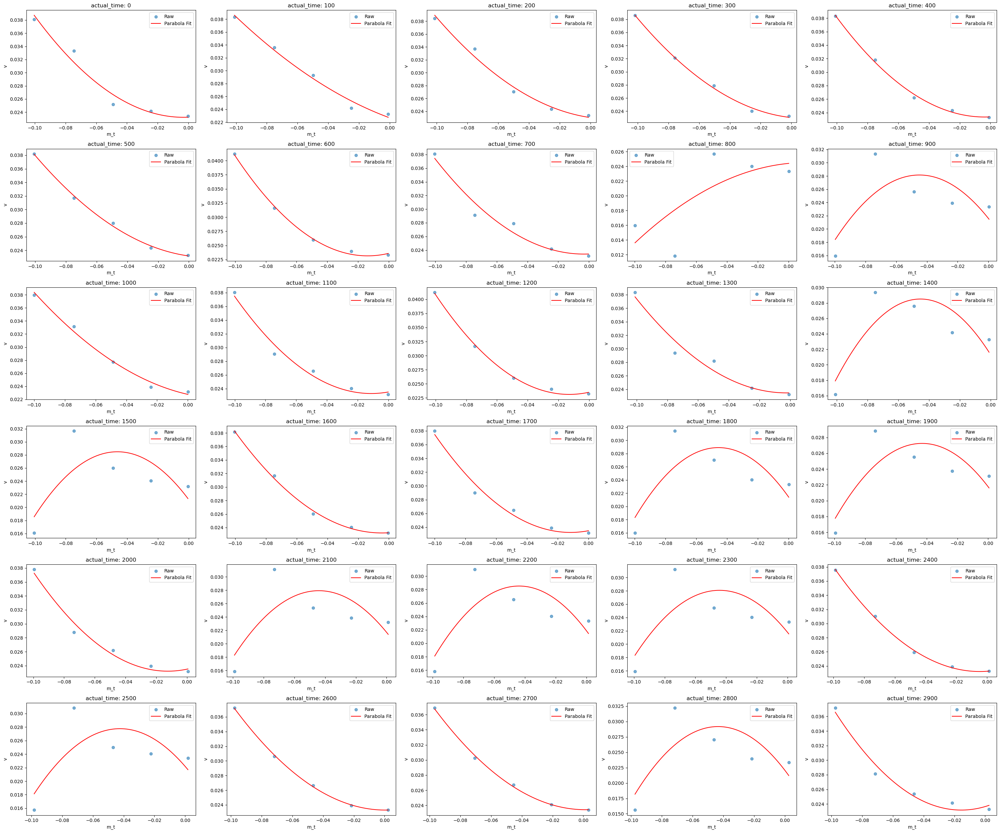

In [142]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Assuming df is your DataFrame
# and columns are named 'actual_time', 'v', and 'm_t'

# Select first 3 unique actual_time values
top3_times = result['actual_time'].dropna().unique()[:30]

plt.figure(figsize=(30, 25))

for i, time in enumerate(top3_times, 1):
    group = result[result['actual_time'] == time]
    x = group['m_t']
    y = group['v']

    # Fit a parabolic curve (2nd-degree polynomial)
    coeffs = np.polyfit(x, y, 2)
    print(coeffs)
    poly = np.poly1d(coeffs)
    x_fit = np.linspace(x.min(), x.max(), 200)
    y_fit = poly(x_fit)

    # Plot original points and curve
    plt.subplot(6, 5, i)
    plt.scatter(x, y, label='Raw', alpha=0.6)
    plt.plot(x_fit, y_fit, color='red', label='Parabola Fit')
    plt.title(f'actual_time: {time}')
    plt.xlabel('m_t')
    plt.ylabel('v')
    plt.legend()

plt.tight_layout()
plt.show()


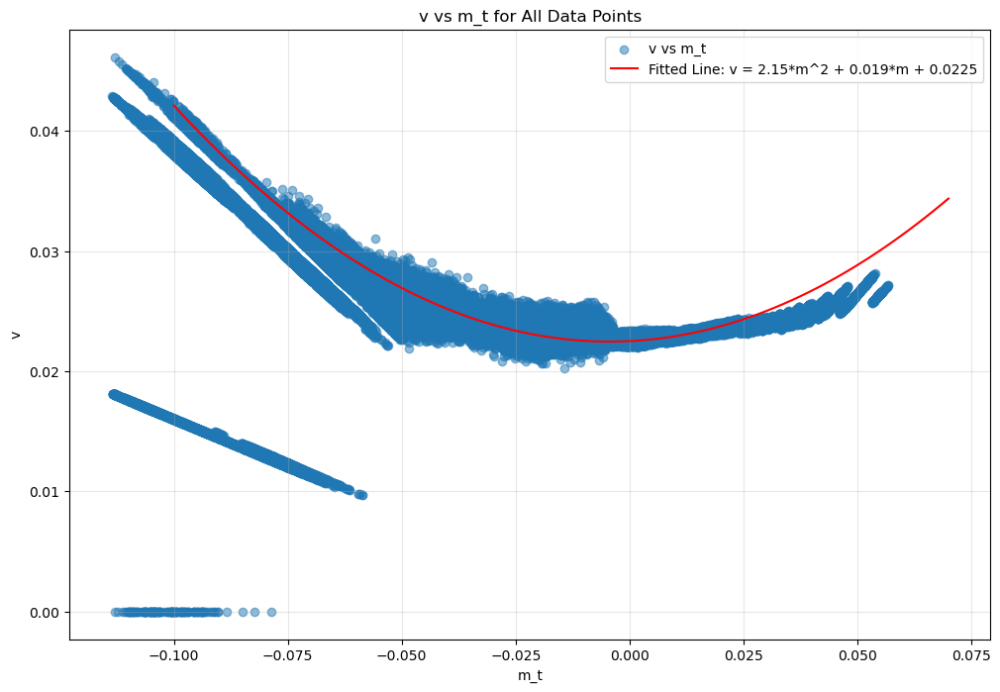

In [190]:
import matplotlib.pyplot as plt

# Plot all v vs m_t from the result dataset
plt.figure(figsize=(12, 8))
plt.scatter(result['m_t'], result['v'], alpha=0.5, label='v vs m_t')
plt.title('v vs m_t for All Data Points')
plt.xlabel('m_t')
plt.ylabel('v')
plt.grid(True, alpha=0.3)
plt.legend()


# Add the line v = 1.64309737*m**2 + 0.0104759*m + 0.02323136 for m values at actual_time = 0
m_values = np.linspace(-0.1, 0.07, 100)
v_values = 2.15 * m_values**2 + 0.019 * m_values + 0.0225
plt.plot(m_values, v_values, color='red', label='Fitted Line: v = 2.15*m^2 + 0.019*m + 0.0225')
plt.legend()

plt.show()

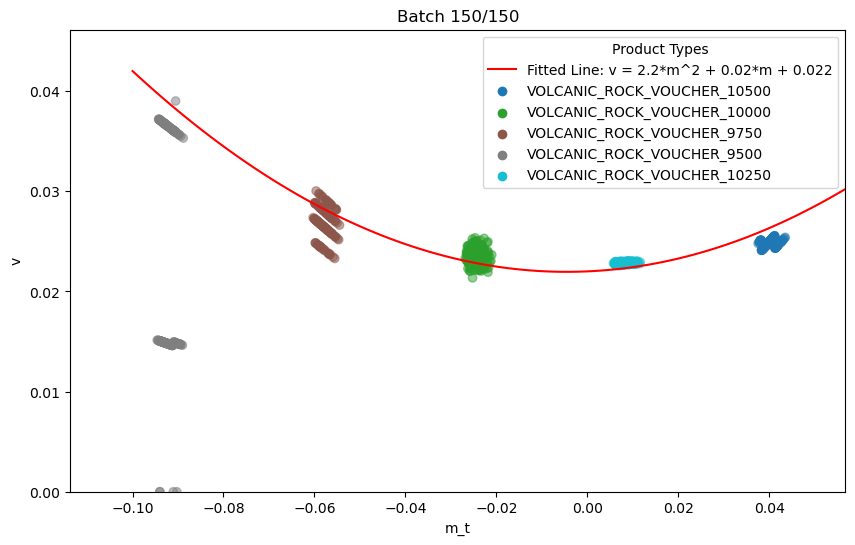

In [195]:
from IPython.display import HTML
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

# Sort the data by actual_time
result_sorted = result.sort_values(by='actual_time')

# Split the data into batches of 100,000 rows
batch_size = 1000
batches = [result_sorted.iloc[i:i + batch_size] for i in range(0, len(result_sorted), batch_size)]

# Assign a unique color to each product type
product_types = result_sorted['product'].unique()
colors = plt.cm.tab10(np.linspace(0, 1, len(product_types)))
color_map = dict(zip(product_types, colors))

# Create the figure and axis
fig, ax = plt.subplots(figsize=(10, 6))
sc = ax.scatter([], [], alpha=0.5)
line, = ax.plot([], [], color='red', label='Fitted Line: v = 2.2*m^2 + 0.02*m + 0.022')

# Set axis limits
ax.set_xlim(result_sorted['m_t'].min(), result_sorted['m_t'].max())
ax.set_ylim(result_sorted['v'].min(), result_sorted['v'].max())
ax.set_title('v vs m_t (Dynamic Visualization)')
ax.set_xlabel('m_t')
ax.set_ylabel('v')
ax.legend()

# Generate the fitted line data
m_values = np.linspace(-0.1, 0.07, 100)
v_values = 2.2 * m_values**2 + 0.02 * m_values + 0.022

# Add annotations for each product type
for product, color in color_map.items():
    ax.scatter([], [], color=color, label=product)
ax.legend(loc='upper right', title='Product Types')

# Update function for animation
def update(frame):
    batch = batches[frame]
    colors = batch['product'].map(color_map)
    sc.set_offsets(batch[['m_t', 'v']].values)
    sc.set_color(colors)
    line.set_data(m_values, v_values)
    ax.set_title(f'Batch {frame + 1}/{len(batches)}')
    return sc, line

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(batches), interval=500, blit=True)

# Display the animation in Jupyter Notebook
HTML(ani.to_jshtml())
